***
# Visualizing Independence Day Speeches
***

## Importing Libraries and packages

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm
from matplotlib.colors import LinearSegmentedColormap, ListedColormap
import seaborn as sns
%matplotlib inline

In [13]:
import re
import string
import nltk
from nltk.tokenize import word_tokenize
from nltk import pos_tag
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer

from wordcloud import WordCloud
from PIL import Image

In [3]:
plt.style.use('default')

## Data Gathering and Preprocessing

In [5]:
def speech_cleaner(text):   
    # Lower Case conversion
    text = text.lower()
    # Tokenize sentences to words
    text = nltk.word_tokenize(text)
    # Remove empty tokens
    text = [w for w in text if len(w) > 0]
    # Remove punctuations
    punct = string.punctuation
    text = [w for w in text if w not in punct]
    # Remove stopwords
    stopword = stopwords.words('english')
    text = [w for w in text if w not in stopword] 
    # POST Tagging the text
    pos_tags = pos_tag(text)
    # Lemmatize the text
    text = [WordNetLemmatizer().lemmatize(w[0]) for w in pos_tags]
    # Removing one letter words
    text = [w for w in text if len(w) > 1]
    # Rejoin all words to get back speech
    speech = " ".join(text)
    return speech

In [6]:
def text_reader_cleaner(file):
    
    text = []
    
    with open(file, 'r') as f:
        text = f.readlines()
    clean_speech = ""
    
    for i in text:
        clean_speech = clean_speech + " " + speech_cleaner(i)
    return clean_speech

In [7]:
years = np.arange(1999,2020)
file_names = [('speech_'+str(y)+'.txt') for y in years]
speech = {}
for year, file in zip(years,file_names):
    speech[year] = text_reader_cleaner(file)

In [8]:
all_speech = ""
all_words = pd.DataFrame([], columns=['year','words'])
for y, s in speech.items():
    all_speech = all_speech + s
    w = pd.Series(re.split("\W+",s))
    w = w.drop(index=w.loc[w.values==''].index)
    all_words = pd.concat([all_words, 
                       pd.DataFrame({'year':len(w)*[y],
                                     'words':w}),
                       ], axis=0)
    all_words = all_words.reset_index(drop=True)

In [9]:
all_words['pos_tag'] = pd.DataFrame(pos_tag(all_words.words))[1]

In [10]:
all_words['chk'] = 1

In [11]:
all_words

,year,words,pos_tag,chk
0,1999,sister,NN,1
1,1999,brother,NN,1
2,1999,dear,JJ,1
3,1999,child,NN,1
4,1999,accept,IN,1
...,...,...,...,...
52889,2019,mother,NN,1
52890,2019,salute,NN,1
52891,2019,mother,NN,1
52892,2019,thanks,NNS,1


## Data Visualisation

In [18]:
nouns = all_words.loc[all_words.pos_tag=='NN'].words.value_counts()/10

In [19]:
names = nouns.loc[nouns.values>5].index
names = names.drop('br')

In [20]:
word_year = pd.pivot_table(all_words, values='chk', index='words', columns='year', aggfunc=np.sum)

In [21]:
def wc_generator(clean_speech, cmap=None):    
    if cmap is None:
        cmap = LinearSegmentedColormap.from_list('india_tricolor', ['orange', 'white', 'green'])
    wordcloud = WordCloud(
                          width=800, height=400,
                          background_color='black',
                          colormap=cmap, 
                          max_words=200,
                          random_state=42
                            ).generate(clean_speech)

    fig, ax = plt.subplots(dpi=400, figsize=[15,10])
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.figure()

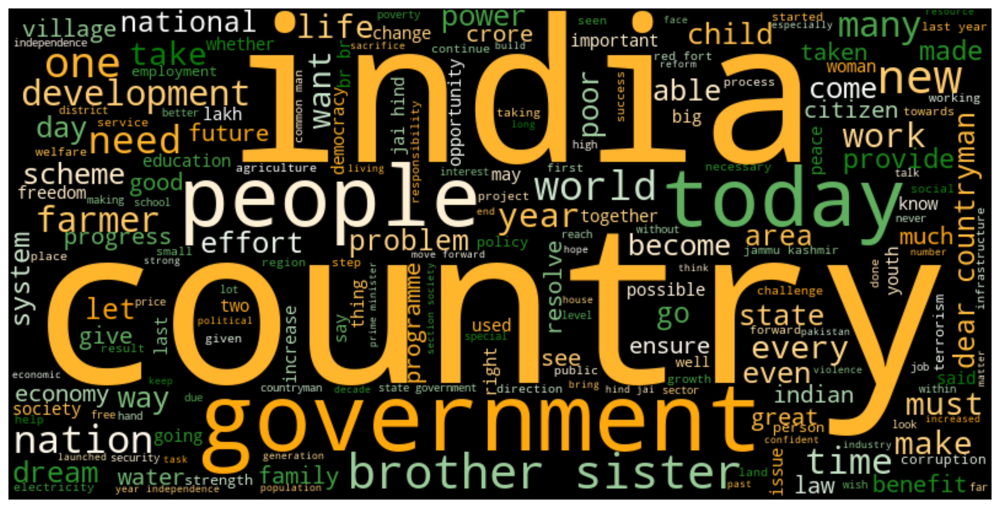

<Figure size 640x480 with 0 Axes>

In [15]:
wc_generator(all_speech)

Text(0.5, 1.0, 'Number of times the top 50 words were mentioned')

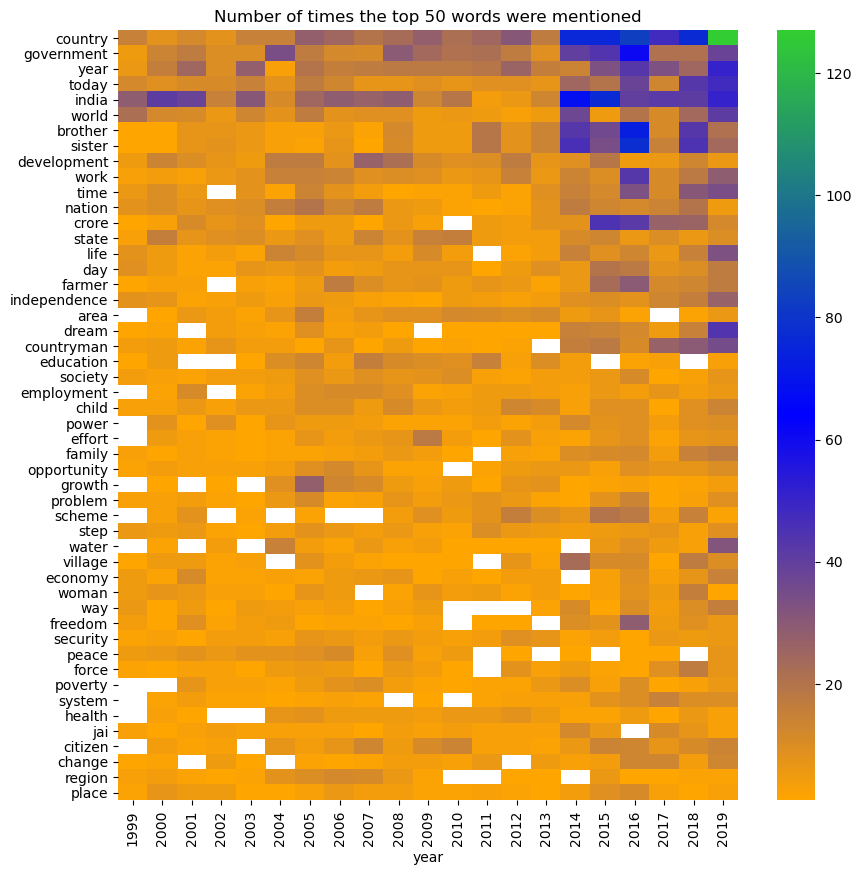

In [22]:
fig,ax = plt.subplots(figsize=[10,10])
colors = ["orange", "blue", "limegreen"]
cmap0 = LinearSegmentedColormap.from_list("india_tricolor", colors)
sns.heatmap(word_year.loc[names[:50]], cmap=cmap0)
plt.title('Number of times the top 50 words were mentioned')

In [16]:
vajp_speech = ""; vajp_words = pd.DataFrame([], columns=['year','words'])
manh_speech = ""; manh_words = pd.DataFrame([], columns=['year','words'])
modi_speech = ""; modi_words = pd.DataFrame([], columns=['year','words'])
for y, s in speech.items():
    if y<2004:
        vajp_speech = vajp_speech + s
        w = pd.Series(re.split("\W+",s))
        w = w.drop(index=w.loc[w.values==''].index)
        vajp_words = pd.concat([vajp_words, 
                           pd.DataFrame({'year':len(w)*[y],
                                         'words':w}),
                           ], axis=0)
        vajp_words = vajp_words.reset_index(drop=True)
    elif (y>=2004)&(y<2014):
        manh_speech = manh_speech + s
        w = pd.Series(re.split("\W+",s))
        w = w.drop(index=w.loc[w.values==''].index)
        manh_words = pd.concat([manh_words, 
                           pd.DataFrame({'year':len(w)*[y],
                                         'words':w}),
                           ], axis=0)
        manh_words = manh_words.reset_index(drop=True)
    else:
        modi_speech = modi_speech + s
        w = pd.Series(re.split("\W+",s))
        w = w.drop(index=w.loc[w.values==''].index)
        modi_words = pd.concat([modi_words, 
                           pd.DataFrame({'year':len(w)*[y],
                                         'words':w}),
                           ], axis=0)
        modi_words = modi_words.reset_index(drop=True)

In [17]:
remove_top = ['india', 'indian', 'government', 'country', 'brother', 'sister', 'brothers','sisters',
              'br', 'year', 'today', 'people','countryman','also']

<Figure size 640x480 with 0 Axes>

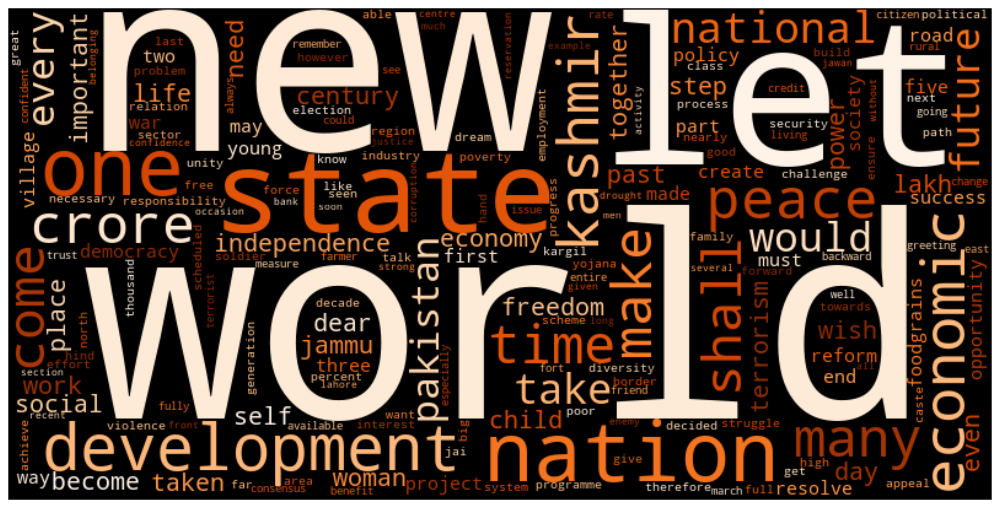

<Figure size 640x480 with 0 Axes>

In [18]:
pm1 = pd.Series([w for w in vajp_words.words if (len(w)>1) & 
                                                (w not in remove_top)&
                                                (w.isdigit() == False)])
                                                

wordcloud = WordCloud(
                          width=800, height=400,
                          background_color='black',
                          colormap='Oranges', 
                          max_words=200,
                          random_state=42
                            ).generate_from_frequencies(pm1.value_counts())

fig, ax = plt.subplots(dpi=400, figsize=[15,10])
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.figure()


<Figure size 640x480 with 0 Axes>

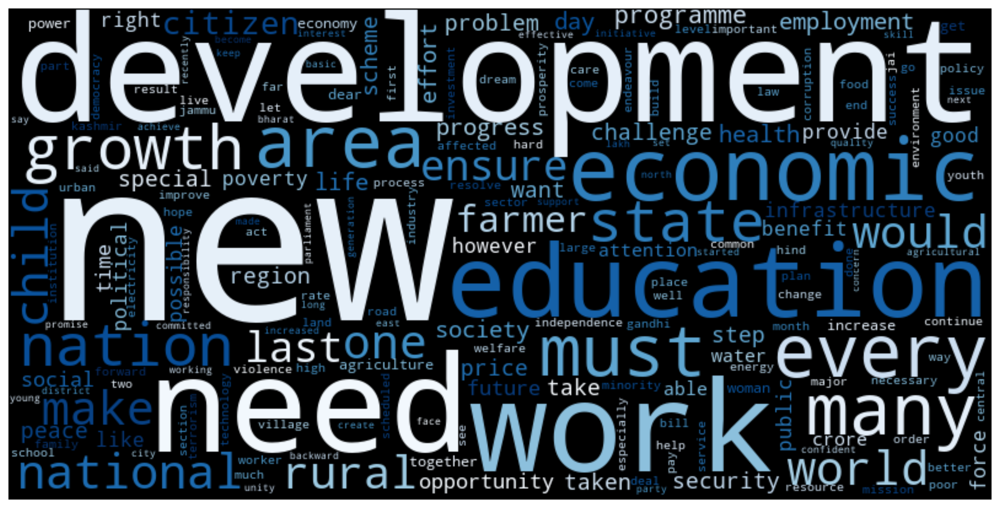

<Figure size 640x480 with 0 Axes>

In [19]:
pm1 = pd.Series([w for w in manh_words.words if (len(w)>1) & 
                                                (w not in remove_top)&
                                                (w.isdigit() == False)])
                                                

wordcloud = WordCloud(
                          width=800, height=400,
                          background_color='black',
                          colormap='Blues', 
                          max_words=200,
                          random_state=42
                            ).generate_from_frequencies(pm1.value_counts())

fig, ax = plt.subplots(dpi=400, figsize=[15,10])
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.figure()

<Figure size 640x480 with 0 Axes>

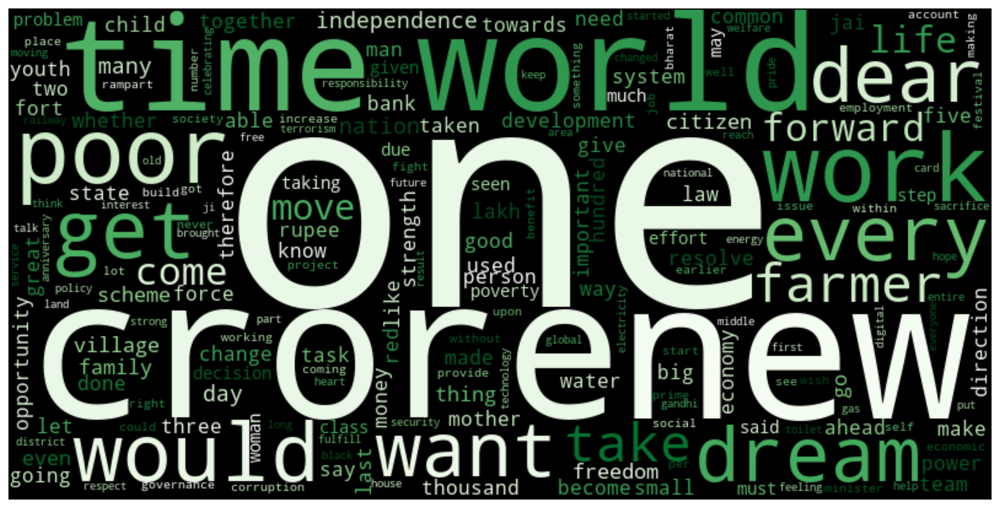

<Figure size 640x480 with 0 Axes>

In [20]:
pm1 = pd.Series([w for w in modi_words.words if (len(w)>1) & 
                                                (w not in remove_top)&
                                                (w.isdigit() == False)])
                                                

wordcloud = WordCloud(
                          width=800, height=400,
                          background_color='black',
                          colormap='Greens', 
                          max_words=200,
                          random_state=42
                            ).generate_from_frequencies(pm1.value_counts())

fig, ax = plt.subplots(dpi=400, figsize=[15,10])
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.figure()


## Speech Lengths

In [23]:
colors = ["orange", "white", "limegreen"]
cmap0 = LinearSegmentedColormap.from_list("india_tricolor", colors)
india_tricolor = cmap0(np.linspace(0,1,21))

In [24]:
speech_time = {
   '1999':26,
   '2000':26,
   '2001':30,
   '2002':23,
   '2003':24,
   '2004':48,
   '2005':50,
   '2006':48,
   '2007':41,
   '2008':42,
   '2009':47,
   '2010':40,
   '2011':34,
   '2012':32,
   '2013':28,
   '2014':65,
   '2015':86,
   '2016':96,
   '2017':57,
   '2018':81,
   '2019':92
    }

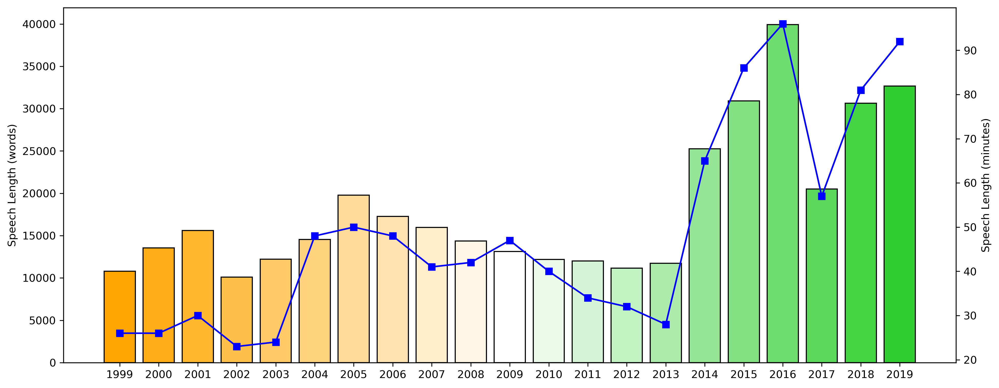

In [25]:
y = []
l = []
for year, text in speech.items():
    y.append(year)
    l.append(len(text))

fig, ax1 = plt.subplots(dpi=300,figsize=[15,6])
ax2 = ax1.twinx()

spt = pd.Series(speech_time).values
for y1, l1, c in zip(y,l, india_tricolor):
    ax1.bar(y1, l1, color=c, edgecolor='k')
    ax1.set_ylabel('Speech Length (words)')
    
ax2.plot(y,spt, marker='s',color='b')
ax2.set_ylabel('Speech Length (minutes)')
    


plt.xticks(np.arange(1999,2020), np.arange(1999,2020).tolist())
plt.show()

In [26]:
df = pd.DataFrame({'year':years,
              'sp_len':spt})
df.loc[df.year<2004,'pm'] = 'abv'
df.loc[df.year<2004,'age'] = np.arange(75,80).tolist()
df.loc[(df.year>=2004) & (df.year<2014), 'pm'] = 'mns'
df.loc[(df.year>=2004) & (df.year<2014), 'age'] = np.arange(72,82).tolist()
df.loc[df.year>=2014, 'pm'] = 'nrm'
df.loc[df.year>=2014, 'age'] = np.arange(64,70).tolist()

In [27]:
from statsmodels.tsa.arima_model import ARIMA
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import mean_squared_error

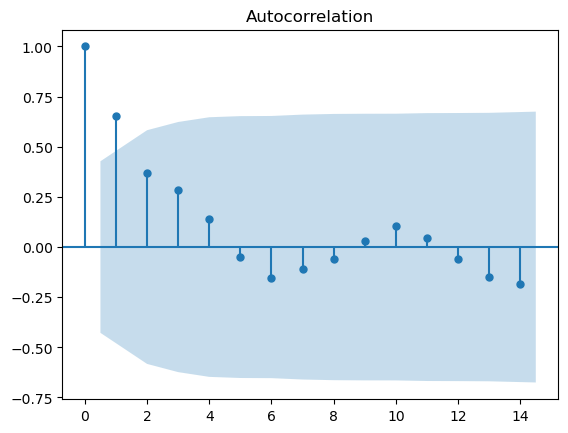

In [28]:
fig = plot_acf(df.sp_len.values)

/Users/anirudhchandra/anaconda3/envs/machine_learning/lib/python3.6/site-packages/statsmodels/regression/linear_model.py:1406: RuntimeWarning: invalid value encountered in sqrt
  return rho, np.sqrt(sigmasq)


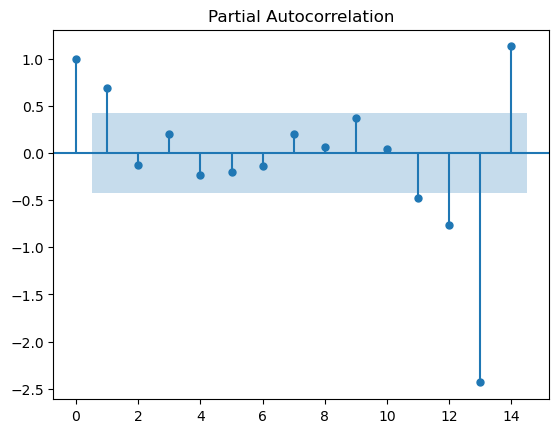

In [29]:
fig = plot_pacf(df.sp_len.values)

We can see that the series is non-stationary, has a lag of 1. The AR parameter may be 1. The I parameter should at least be 1 and MA parameter should also be 1.

## Prediction for 2020

In [34]:
X = df.sp_len.values
size = int(len(X) * 0.6)
train, test = X[0:size], X[size:len(X)]
sp_years = df.iloc[size:, 0].reset_index(drop=True)
history = [x for x in train]
predictions = list()
for t in range(len(test)):
    model = ARIMA(history, order=(1,1,0))
    # The hyperparameter, p for AR is 1, meaning lag 1
    # THe hyperparameter, d, for I is 1, meaning differencing the time series once
    # The hyperparameter, q, for MA is 0, meaning no moving average of residuals is necessary
    model_fit = model.fit(disp=0)
    output = model_fit.forecast()
    yhat = output[0]
    predictions.append(yhat)
    obs = test[t]
    history.append(obs)
    print(sp_years[t])
    print('predicted=%f, expected=%f' % (yhat, obs))
error = np.sqrt(mean_squared_error(test, predictions))
print('Test RMSE: %.3f' % error)

2011
predicted=41.497464, expected=34.000000
2012
predicted=34.293300, expected=32.000000
2013
predicted=32.275443, expected=28.000000
2014
predicted=27.779659, expected=65.000000
2015
predicted=64.317813, expected=86.000000
2016
predicted=94.102461, expected=96.000000
2017
predicted=101.639437, expected=57.000000
2018
predicted=52.350426, expected=81.000000
2019
predicted=81.350816, expected=92.000000
Test RMSE: 23.252


In [35]:
# fit model
model = ARIMA(df.sp_len.values, order=(1,1,0))

In [36]:
model_fit = model.fit(disp=0)
print(model_fit.summary())

                             ARIMA Model Results                              
Dep. Variable:                    D.y   No. Observations:                   20
Model:                 ARIMA(1, 1, 0)   Log Likelihood                 -83.009
Method:                       css-mle   S.D. of innovations             15.354
Date:                Sat, 15 Aug 2020   AIC                            172.018
Time:                        09:17:43   BIC                            175.005
Sample:                             1   HQIC                           172.601
                                                                              
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          3.2855      3.220      1.020      0.307      -3.025       9.596
ar.L1.D.y     -0.0700      0.219     -0.319      0.749      -0.500       0.360
                                    Roots           

In [37]:
model_fit.forecast()[0]

array([94.7455458])